In [1]:
!pip install nussl
!pip install demucs

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [2]:
import nussl
import matplotlib.pyplot as plt
import time
import warnings


    If you do not have SoX, proceed here:
     - - - http://sox.sourceforge.net/ - - -

    If you do (or think that you should) have SoX, double-check your
    path variables.
    


In [3]:
def visualize_and_embed(sources, y_axis='mel'):
    plt.figure(figsize=(10, 4))
    plt.subplot(111)
    nussl.utils.visualize_sources_as_masks(
        sources, db_cutoff=-60, y_axis=y_axis)
    plt.tight_layout()
    plt.show()
    nussl.play_utils.multitrack(sources, ext='.wav')

In [4]:
# download the dataset
# this command downloads a 7 second clip of a each music and stem
musdb = nussl.datasets.MUSDB18(download=True)
audio_signal = musdb[3]['mix']

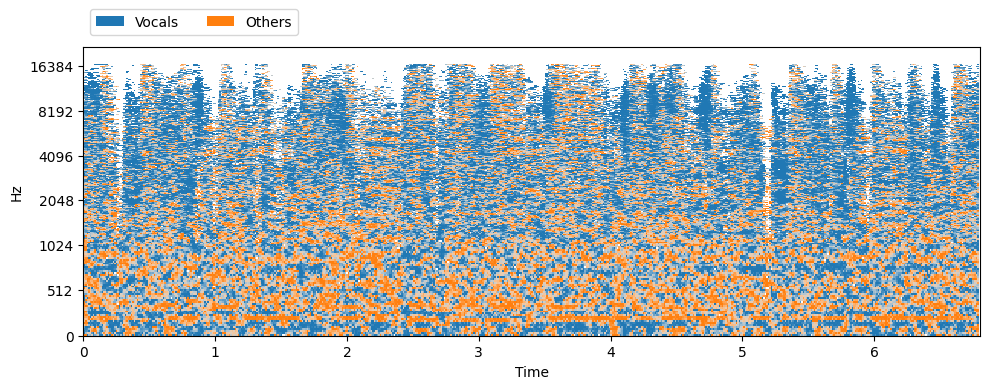


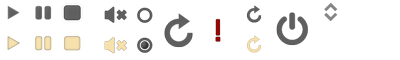
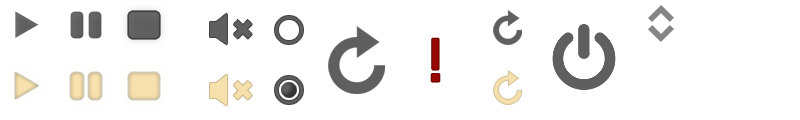
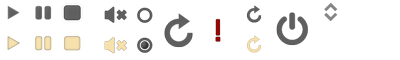

In [5]:
separator = nussl.separation.spatial.Duet(
    audio_signal, num_sources=2)
estimates = separator()

estimates = {
    'Vocals': estimates[0],
    'Others': estimates[1]
}

visualize_and_embed(estimates)

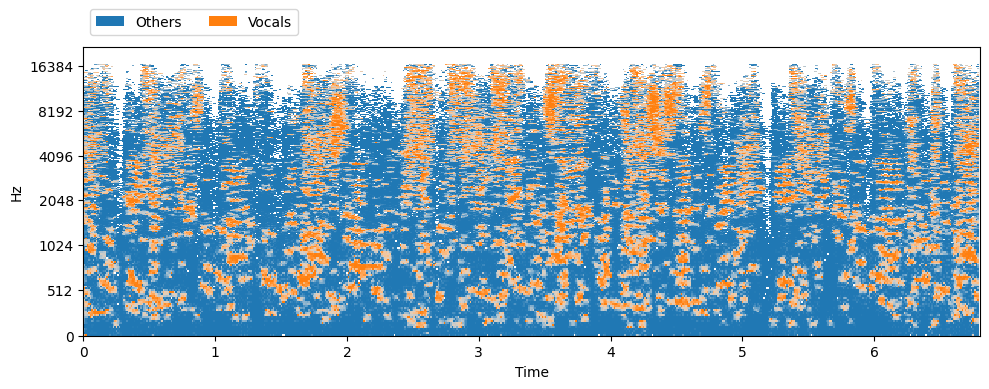


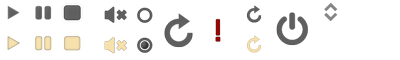
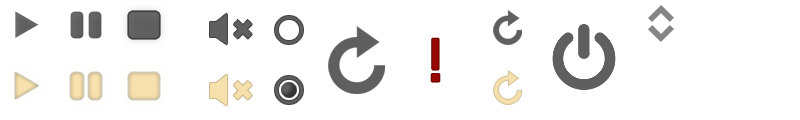
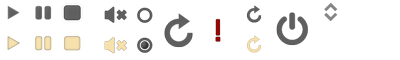

In [6]:
ft2d = nussl.separation.primitive.FT2D(
    audio_signal, mask_type='binary')
estimates = ft2d()

estimates = {
    'Others': estimates[0],
    'Vocals': estimates[1]
}

visualize_and_embed(estimates)

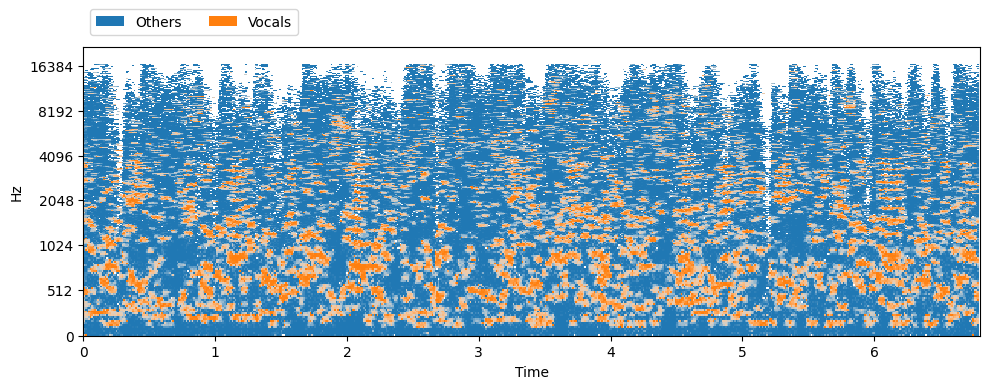


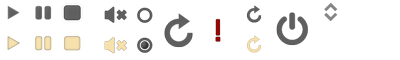
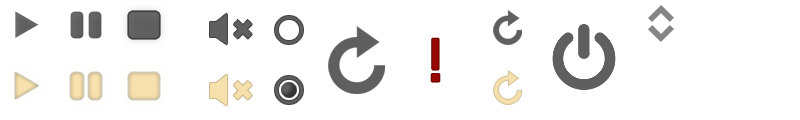
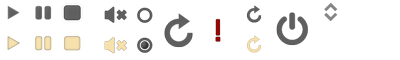

In [7]:
separator = nussl.separation.factorization.RPCA(audio_signal)
estimates = separator()

estimates = {
    'Others': estimates[0],
    'Vocals': estimates[1]
}

visualize_and_embed(estimates)

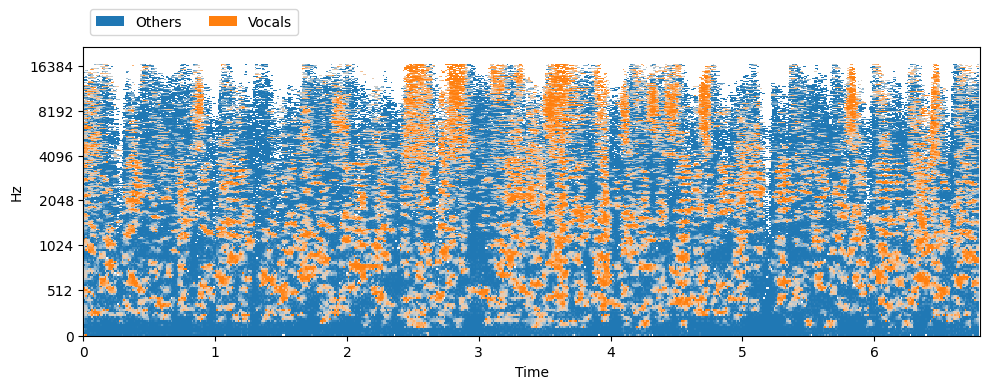


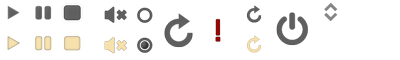
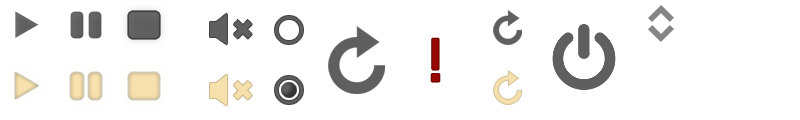
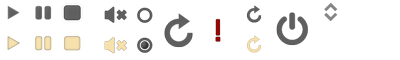

In [8]:
separator = nussl.separation.primitive.Repet(
    audio_signal, mask_type='binary')
estimates = separator()

estimates = {
    'Others': estimates[0],
    'Vocals': estimates[1]
}

visualize_and_embed(estimates)


In [9]:
import os
import requests
from google_drive_downloader import GoogleDriveDownloader as gdd

def download_file_from_google_drive(file_id, dest_path):
    gdd.download_file_from_google_drive(file_id=file_id, dest_path=dest_path)

# Replace 'file_id' and 'dest_path' with the actual file ID and destination path, respectively
file_id = '1Oo3e5HyQs3TAFiBPsjoASeoNC7gpll9Y'
dest_path = '/content/sample_data/audio_example_mono.mp3'

# Download the file from Google Drive
download_file_from_google_drive(file_id, dest_path)

In [10]:
!pip install --upgrade librosa

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [11]:
# !python -m demucs.separate /content/audio_example_mono1.mp3
!python -m demucs.separate /content/sample_data/audio_example_mono.mp3

Important: the default model was recently changed to `htdemucs` the latest Hybrid Transformer Demucs model. In some cases, this model can actually perform worse than previous models. To get back the old default model use `-n mdx_extra_q`.
Selected model is a bag of 1 models. You will see that many progress bars per track.
Separated tracks will be stored in /content/separated/htdemucs
Separating track /content/sample_data/audio_example_mono.mp3
100%|██████████████████████████████████████████████████████████████████████████| 11.7/11.7 [00:42<00:00,  3.64s/seconds]


In [12]:
import os

def visualize_and_embed(audio_dir, y_axis='mel'):
    sources = {}
    for i, file_name in enumerate(os.listdir(audio_dir)):
        file_path = os.path.join(audio_dir, file_name)
        audio_signal = nussl.AudioSignal(file_path)
        sources[f'Source {i+1}'] = audio_signal
        
    plt.figure(figsize=(10, 4))
    plt.subplot(111)
    nussl.utils.visualize_sources_as_masks(
        sources, db_cutoff=-60, y_axis=y_axis)
    plt.tight_layout()
    plt.show()
    
    for source_name, audio_signal in sources.items():
        audio_signal.write_audio_to_file(f'{source_name}.wav')
    nussl.play_utils.multitrack(sources, ext='.wav')


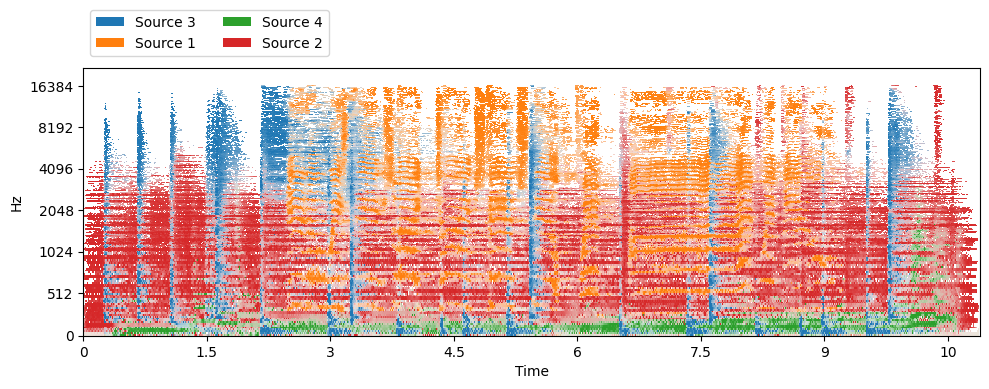


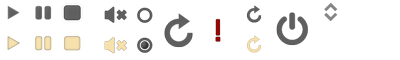
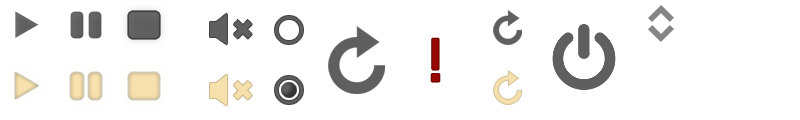
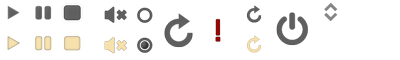

In [13]:
# audio_dir = '/content/separated/htdemucs/audio_example_mono1'
audio_dir = '/content/separated/htdemucs/audio_example_mono'
visualize_and_embed(audio_dir)